<a href="https://colab.research.google.com/github/UdeS-PMF/gmq710_test/blob/develop/a2024_gmq710_firststep.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Utiliser Colab pour développer

Prenons le fichier CSV des délits dans la Ville de Montréal (interventionscitoyendo2020.zip). Ce fichier contient des colonnes Latitude et Longitude permettant de spatialiser la donnée.

- On souhaite donc lire le fichier CSV

- Convertir en GeoDataframe (GeoPandas)

- Conserver uniquement les points cohérents

- Afficher les points sur une carte

- Faire des graphiques

Faisons quelques analyses :

- affichons les points uniquement de l'année 2020 (ou 2019 ou 2018)

- où se trouve les crimes par Introduction (au mois d'avril 2020) ?

- où se déroulent les crimes selon la période de la journée (au mois d'avril 2020) ?

## On importe les libs

Ce sont les mêmes libs que pour un développement local

Si jamais une librairie manque, il suffit d'utiliser la commande :



```
!pip install ....
```



In [ ]:
# j'importe pandas
import pandas as pd
# j'importe geopandas
import geopandas as gpd
# on va utiliser le Point
from shapely.geometry import Point
# et matplotlib pour l'affichage
import matplotlib.pyplot as plt

## On connecte son compte drive

L'intérêt de connecter le drive est d'accéder à des données directement en ligne (sans avoir à les télécharger à chaque fois)

In [ ]:
# Connecter un répertoire de google drive

from google.colab import drive
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


In [ ]:
# lister les données

!ls "/content/drive/My Drive/a2024-gmq710"

BEN_satellite_TIF.zip	       Limites_PDQ_2016_Lat_Long.sbn	  Limites_PDQ_2016_Lat_Long.shx
interventionscitoyendo.csv     Limites_PDQ_2016_Lat_Long.sbx	  results
Limites_PDQ_2016_Lat_Long.dbf  Limites_PDQ_2016_Lat_Long.shp
Limites_PDQ_2016_Lat_Long.prj  Limites_PDQ_2016_Lat_Long.shp.xml


In [ ]:
# on déclare le fichier csv à lire
# il a 2 colonnes Longitude et Latitude que l'on transforme en point
filename = r'/content/drive/MyDrive/a2024-gmq710/interventionscitoyendo.csv'
# on lit le csv avec Pandas
df = pd.read_csv(filename, encoding='windows-1252', parse_dates=['DATE'])

# columns : CATEGORIE	DATE	QUART	PDQ	X	Y	LONGITUDE	LATITUDE

# on va écarter les longitudes et latitudes non conformes
filterdf = df[(df['LONGITUDE'] != 1) & (df['LATITUDE'] != 1)]
# on constitue le geodataframe
geodata = gpd.GeoDataFrame(filterdf, crs='EPSG:4326',
                           geometry=[
                               Point(xy) for xy in zip(filterdf.LONGITUDE, filterdf.LATITUDE)])

# on souhaite afficher les points pour l'année 2020
year = 2020
geodata['YEAR'] = geodata['DATE'].dt.year

resu_2020 = geodata[geodata['DATE'].dt.year == year]

# compare pour chaque catégorie les années 2018 et 2019
df_filtered = geodata[geodata["YEAR"].isin([2018, 2019])]
# Compter le nombre de lignes par CATEGORIE et YEAR
category_counts = df_filtered.groupby(["CATEGORIE", "YEAR"]).size().reset_index(name="COUNT")

# Afficher les premières lignes des résultats
print(category_counts)

                           CATEGORIE  YEAR  COUNT
0     Infractions entrainant la mort  2018     24
1     Infractions entrainant la mort  2019     20
2                       Introduction  2018   7052
3                       Introduction  2019   6715
4                             Méfait  2018   5219
5                             Méfait  2019   5051
6   Vol dans / sur véhicule à moteur  2018   6293
7   Vol dans / sur véhicule à moteur  2019   5750
8           Vol de véhicule à moteur  2018   3409
9           Vol de véhicule à moteur  2019   3406
10                    Vols qualifiés  2018   1284
11                    Vols qualifiés  2019   1396


## Utiliser des outils de colab pour afficher les résultats

In [ ]:
# utiliser foluim pour afficher des cartes
import folium
# Créer une carte centrée sur le premier point

first_point = resu_2020.iloc[0]
center_lat = first_point.geometry.y
center_lon = first_point.geometry.x

carte = folium.Map(location=[center_lat, center_lon], zoom_start=11)

# Itérer sur les points du GeoDataFrame et ajouter des marqueurs
for index, row in resu_2020.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(carte)

carte

Il est possible d'afficher des shapefiles

In [ ]:
import geopandas as gpd

# Lire le shapefile
shapefile_path = "/content/drive/MyDrive/a2024-gmq710/Limites_PDQ_2016_Lat_Long.shp"
gdf = gpd.read_file(shapefile_path)


# centroid du premier polygone
centroid = gdf.iloc[0].geometry.centroid
latitude = centroid.y
longitude = centroid.x

# Créer une carte centrée sur une localisation
m = folium.Map(location=[latitude, longitude], zoom_start=10)

# Ajouter le GeoDataFrame directement à la carte
folium.GeoJson(
    gdf,
    name="Shapefile Layer",
    tooltip=folium.GeoJsonTooltip(fields=list(gdf.columns[:1]))
).add_to(m)

for index, row in resu_2020.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6
    ).add_to(m)
# Ajouter des contrôles pour les couches
folium.LayerControl().add_to(m)

# Afficher ou sauvegarder la carte
m



In [ ]:
# Si on souhaite créer un jeu de données avec une colonne pour les valeurs de 2018 et une colonne pour les valeurs en 2019

# on doit faire pivoter le dataframe
category_counts_pivot = category_counts.pivot(index="CATEGORIE", columns="YEAR", values="COUNT").reset_index()

# On renomme les colonnes pour plus de clarté
category_counts_pivot = category_counts_pivot.rename(columns={2018: "COUNT_2018", 2019: "COUNT_2019"})

# 6. Remplacer les valeurs NaN par 0 si nécessaire
category_counts_pivot = category_counts_pivot.fillna(0)

# Afficher les premières lignes des résultats
category_counts_pivot


YEAR,CATEGORIE,COUNT_2018,COUNT_2019
0,Infractions entrainant la mort,24,20
1,Introduction,7052,6715
2,Méfait,5219,5051
3,Vol dans / sur véhicule à moteur,6293,5750
4,Vol de véhicule à moteur,3409,3406
5,Vols qualifiés,1284,1396


On peut utiliser de nombreux outils pour affichers des graphiques

In [ ]:
import plotly.express as px

# 4. Créer un bar chart comparatif avec Plotly Express
fig = px.bar(
    category_counts_pivot,
    x="CATEGORIE",
    y=["COUNT_2018", "COUNT_2019"],

    barmode="group",
    title="Comparaison des catégories entre 2018 et 2019",
    labels={"CATEGORIE": "Catégorie", "COUNT": "Nombre de crimes"}
)

fig.show()

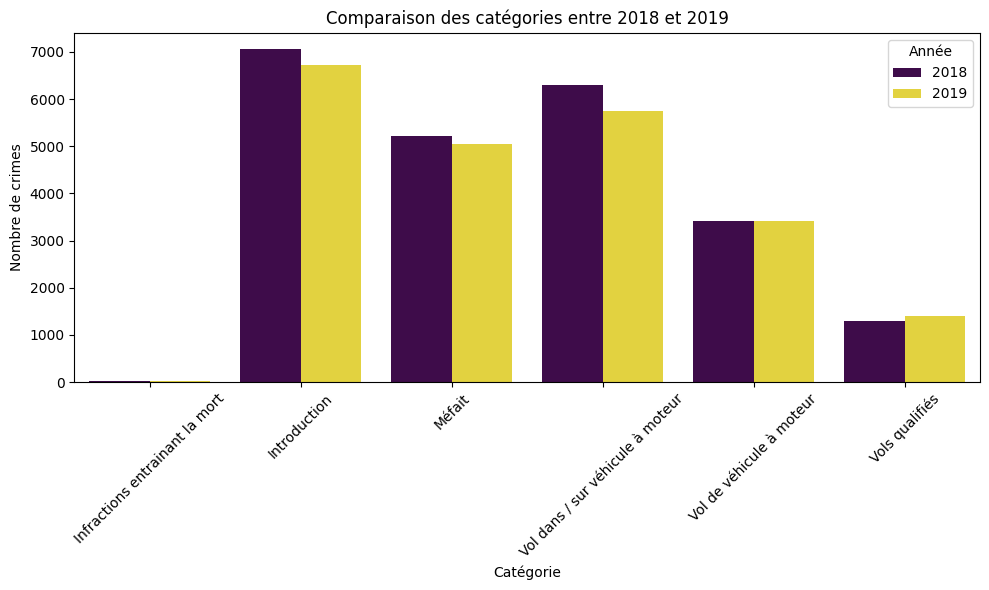

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# 4. Initialiser une figure
plt.figure(figsize=(10, 6))

# 5. Créer un bar chart avec Seaborn
sns.barplot(
    data=category_counts,
    x="CATEGORIE",
    y="COUNT",
    hue="YEAR",  # Utiliser l'année pour différencier les barres
    palette="viridis"  # Palette de couleurs
)

# 6. Ajouter des labels et un titre
plt.title("Comparaison des catégories entre 2018 et 2019")
plt.xlabel("Catégorie")
plt.ylabel("Nombre de crimes")
plt.xticks(rotation=45)  # Tourner les étiquettes pour améliorer la lisibilité
plt.legend(title="Année")  # Légende pour les années

# 7. Afficher le graphique
plt.tight_layout()
plt.show()

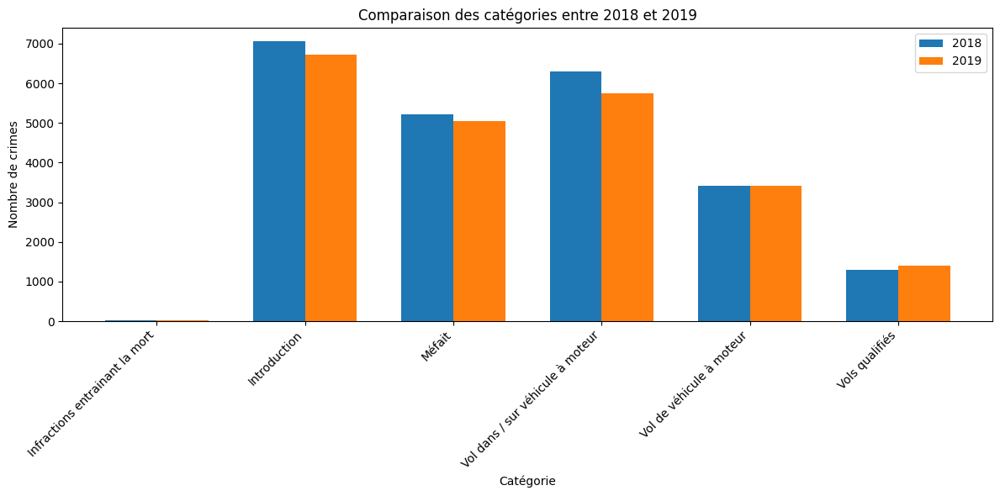

In [ ]:
# Afficher les résultats avec matplotlib (barres côte à côte)

# Créer un bar chart comparatif avec Matplotlib
width = 0.35  # Largeur des barres

fig, ax = plt.subplots(figsize=(12, 6))

# Obtenir les index uniques des catégories
categories = category_counts_pivot["CATEGORIE"].unique()

# Créer les positions des barres sur l'axe des x
x = range(len(categories))

# Tracer les barres pour 2018
ax.bar([i - width / 2 for i in x], category_counts_pivot["COUNT_2018"], width, label="2018")

# Tracer les barres pour 2019
ax.bar([i + width / 2 for i in x], category_counts_pivot["COUNT_2019"], width, label="2019")


ax.set_xlabel("Catégorie")
ax.set_ylabel("Nombre de crimes")
ax.set_title("Comparaison des catégories entre 2018 et 2019")
ax.set_xticks(x)
ax.set_xticklabels(categories, rotation=45, ha="right")  # Tourner les étiquettes pour améliorer la lisibilité
ax.legend()

plt.tight_layout()
plt.show()

## Sauvegarder les résultats

In [ ]:
# sauvegarder dans un fichier csv

# Sauvegarder le DataFrame category_counts_pivot dans un fichier CSV
category_counts_pivot.to_csv('/content/drive/MyDrive/a2024-gmq710/results/category_counts_pivot.csv', index=False)
